In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import os
import glob2 as glob
import torch
import skimage as skio 
from skimage.measure import regionprops
from torch.utils.data import DataLoader
from src.utilities.data_utilities import PointDataReg
from torch.utils.data.sampler import SubsetRandomSampler
from src.point_net_nl.point_net import PointNetRegHead
from src.point_net_nl.point_net_loss import PointNetRegLoss

In [2]:
root = "/media/nick/hdd02/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/pecfin_dynamics/"
fluo_channel = "tbx5a-StayGold_mean_nn"
training_dates = ["20240424", "20240425"]
point_cloud_size = 4096

# get path to stitched masks
seg_model = "log-v5"
mask_dir = os.path.join(root, "stitched_labels", seg_model, "")

# Path to models
# model_dir = os.path.join(root, "built_data", "nucleus_data", "point_models", "*")
# model_list = sorted(glob.glob(model_dir))
# model_path = os.path.join(model_list[-1], "*") # take most recent
# print(model_path)
# train_iter_list = sorted(glob.glob(model_path))
# train_iter_path = train_iter_list[-1]
# print(train_iter_path)

In [3]:
# use dataloader to import sample point clouds
data_root = os.path.join(root, "built_data", "nucleus_data", "point_clouds")

# generate dataloader to load fin point clouds
point_data = PointDataReg(data_root, split='test', training_dates=training_dates, npoints=point_cloud_size, fluo_channel=fluo_channel, 
                          r_prob=0, shear_prob=0, cut_prob=1)

train_loader = DataLoader(point_data, batch_size=16, shuffle=True)

In [4]:
# # check for GPU
# device = 'cuda' if torch.cuda.is_available() else 'cpu'

# # load pretrained model
# model = PointNetRegHead(num_points=point_cloud_size).to(device)
# model.load_state_dict(torch.load(train_iter_path)) # load weights from previous training as starting point
# model.eval()

batch = next(iter(train_loader))

points = batch["data"]
levels = batch["label"]
paths = batch["path"]
# points = torch.transpose(points, 1, 2)

# # pass to device
# points = points.to(device)
# levels = levels.to(device)

# # get softmax predictions
# preds, _, _, features = model(points)

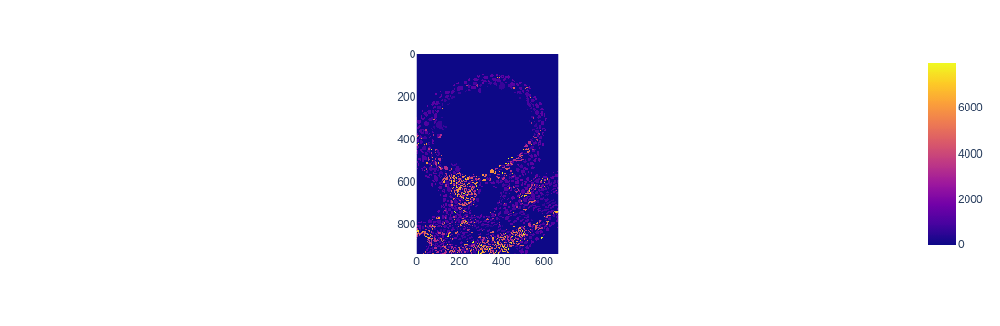

In [85]:
import zarr 

# load masks for a given cloud time point and calculate mask features
experiment_date = "20240223"
seg_model = "log-v5"
mask_directory = os.path.join(root, "built_data", "stitched_labels", seg_model, experiment_date, '')

well_index = 12
time_index = 50

file_prefix = experiment_date + f"_well{well_index:04}"
mask_zarr_path = os.path.join(mask_directory, file_prefix + "_labels_stitched.zarr")
mask_zarr = zarr.open(mask_zarr_path, mode='r')
mask_zarr.shape

fig = px.imshow(mask_zarr[0, 30, :, :])
fig.show()

In [86]:
from scipy.ndimage import zoom

scale_vec = np.asarray([1.0, 0.55, 0.55])
# get raw mask data

data_zyx = mask_zarr[time_index]

# get resizing info
# shape_orig = np.asarray(data_zyx.shape)
# shape_iso = shape_orig.copy()
# iso_factor = scale_vec[0] / scale_vec[1]
# shape_iso[0] = int(shape_iso[0] * iso_factor)

# zoom_factor = np.divide(shape_iso, shape_orig)
# data_zyx_rs = zoom(data_zyx, zoom_factor, order=0)

# get basic mask features
regions = regionprops(data_zyx)#, spacing=tuple(scale_vec))
area_vec = np.asarray([rg["Area"] for rg in regions])
lb_vec = np.asarray([rg["label"] for rg in regions])
feature_df = pd.DataFrame(lb_vec, columns=["nucleus_id"])
feature_df["size"] = area_vec
feature_df[["Z", "Y", "X"]] = np.asarray([rg["Centroid"] for rg in regions])
feature_df["Z"] = -feature_df["Z"]

fig = px.scatter_3d(feature_df, x="X", y="Y", z="Z", color="size", range_color=(0,1000))
fig.show()

In [87]:
import math
import numpy as np

def ellipsoid_axis_lengths(central_moments):
    """Compute ellipsoid major, intermediate and minor axis length.

    Parameters
    ----------
    central_moments : ndarray
        Array of central moments as given by ``moments_central`` with order 2.

    Returns
    -------
    axis_lengths: tuple of float
        The ellipsoid axis lengths in descending order.
    """
    m0 = central_moments[0, 0, 0]
    sxx = central_moments[2, 0, 0] / m0
    syy = central_moments[0, 2, 0] / m0
    szz = central_moments[0, 0, 2] / m0
    sxy = central_moments[1, 1, 0] / m0
    sxz = central_moments[1, 0, 1] / m0
    syz = central_moments[0, 1, 1] / m0
    S = np.asarray([[sxx, sxy, sxz], [sxy, syy, syz], [sxz, syz, szz]])
    # determine eigenvalues in descending order
    eigvals = np.sort(np.linalg.eigvalsh(S))[::-1]
    eigvals[eigvals<0] = 0
    return tuple([math.sqrt(5.0 * e) for e in eigvals])


def ellipsoid_axis_loadings(central_moments):
    """Compute ellipsoid major, intermediate and minor axis length.

    Parameters
    ----------
    central_moments : ndarray
        Array of central moments as given by ``moments_central`` with order 2.

    Returns
    -------
    axis_lengths: tuple of float
        The ellipsoid axis lengths in descending order.
    """
    m0 = central_moments[0, 0, 0]
    sxx = central_moments[2, 0, 0] / m0
    syy = central_moments[0, 2, 0] / m0
    szz = central_moments[0, 0, 2] / m0
    sxy = central_moments[1, 1, 0] / m0
    sxz = central_moments[1, 0, 1] / m0
    syz = central_moments[0, 1, 1] / m0
    S = np.asarray([[sxx, sxy, sxz], [sxy, syy, syz], [sxz, syz, szz]])
    
    # # determine eigenvalues in descending order
    eigvals, eigvecs = np.linalg.eig(S)
    eigpower = np.sum(np.multiply(np.asarray(eigvals)[np.newaxis, :]**2, np.asarray(np.abs(eigvecs))), axis=1)
    eigpower = eigpower / np.sum(np.abs(eigpower))
    return eigpower

In [95]:
feature_df[["e0", "e1", "e2"]] = np.asarray([ellipsoid_axis_lengths(rg["moments_central"]) for rg in regions])
feature_df[["pZ", "pY", "pX"]] = np.asarray([ellipsoid_axis_loadings(rg["moments_central"]) for rg in regions])
# feature_df.loc[:, ["pZ", "pY", "pX"]] = np.divide(feature_df.loc[:, ["pZ", "pY", "pX"]], np.max(feature_df.loc[:, ["pZ", "pY", "pX"]], axis=1))
feature_df["eccentricity"] = np.divide(feature_df["e0"].to_numpy(), np.sqrt(np.sum(feature_df.loc[:, ["e0", "e1", "e2"]].to_numpy()**2, axis=1))) #1 - np.divide(feature_df["size"], (1.33 * np.pi * feature_df["e0"]**3))
feature_df["eccentricity"] = (feature_df["eccentricity"] - 1/np.sqrt(3)) / (1-1/np.sqrt(3))

fig = px.scatter_3d(feature_df, x="X", y="Y", z="Z", color="pX", color_continuous_scale="magma", range_color=(0,1))
fig.show()

In [96]:
from sklearn.neighbors import KDTree

# Average across nearest neighbors for both nucleus- and cell-based mRNA estimates
nn_k = 5
tree = KDTree(feature_df[["Z", "Y", "X"]], leaf_size=2)
nearest_dist, nearest_ind = tree.query(feature_df[["Z", "Y", "X"]], k=nn_k + 1)

ch_list = ["pZ", "pY", "pX", "size", "eccentricity"]
for ch in ch_list:
    p_array = feature_df.loc[:, ch].to_numpy()
    p_array_nn = p_array[nearest_ind]
    feature_df[ch + "_nn"] = np.mean(p_array_nn, axis=1)


In [111]:
fig = px.scatter_3d(feature_df, x="X", y="Y", z="Z", color="pX_nn", color_continuous_scale="magma")
fig.show()

In [114]:
from tqdm import tqdm
mask_slice = data_zyx[32, :, :]
labels_u = np.unique(mask_slice)
labels_u = labels_u[labels_u > 0]


pX_mask = np.zeros(mask_slice.shape, dtype=np.float32)
pY_mask = np.zeros(mask_slice.shape, dtype=np.float32)
e_mask = np.zeros(mask_slice.shape, dtype=np.float32)
s_mask = np.zeros(mask_slice.shape, dtype=np.float32)
for i, lb in enumerate(tqdm(labels_u)):
    df_filter = feature_df["nucleus_id"] == lb
    pX_mask[mask_slice == lb] =  feature_df.loc[df_filter, "pX_nn"]
    pY_mask[mask_slice == lb] =  feature_df.loc[df_filter, "pY_nn"]
    e_mask[mask_slice == lb] = feature_df.loc[df_filter, "eccentricity"]
    s_mask[mask_slice == lb] =  feature_df.loc[df_filter, "size"]

100%|██████████| 1513/1513 [00:02<00:00, 690.82it/s]


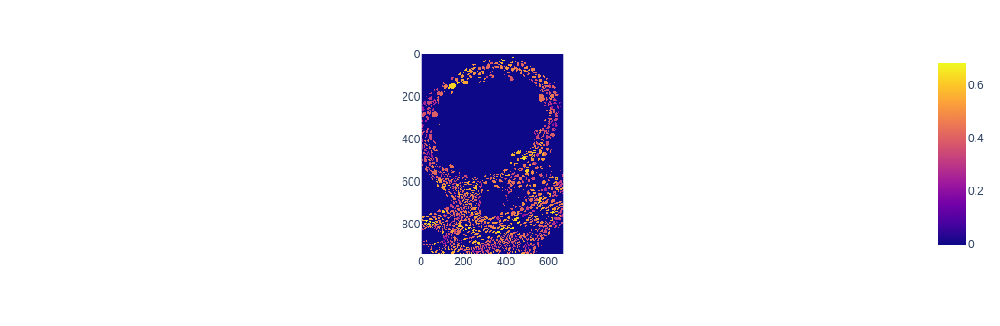

In [115]:
fig = px.imshow(pX_mask)
fig.show()


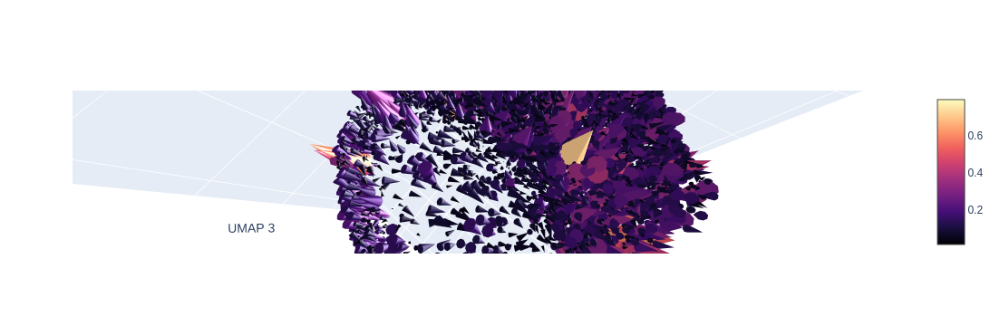

In [114]:
fig = go.Figure()

fig.update_layout(scene = dict(
                xaxis_title='UMAP 1',
                yaxis_title='UMAP 2',
                zaxis_title='UMAP 3',
                xaxis = dict(showticklabels=False),
                yaxis = dict(showticklabels=False),
                zaxis = dict(showticklabels=False)))

angle = 0
za = 0.2
vec = np.asarray([math.cos(angle), math.sin(angle), za])
vec = vec*2
camera = dict(
eye=dict(x=vec[0], y=vec[1], z=vec[2]))
    
# lim_scene =  dict(
                # xaxis = dict(nticks=4, range=[-2, 12],),
                # yaxis = dict(nticks=4, range=[-10, 12],),
                # zaxis = dict(nticks=4, range=[-7.5, 10],),)

fig.update_layout(scene_camera=camera, scene_dragmode='orbit')
    #define the trace for triangle sides
cones = go.Cone(
    x=feature_df["X"],
    y=feature_df["Y"],
    z=feature_df["Z"],
    u=feature_df["pX_nn"],
    v=feature_df["pY_nn"],
    w=feature_df["pZ_nn"],
    colorscale="magma",
    sizemode="absolute",
    sizeref=25, 
    # anchor="tip",
    showscale=True,
lighting_specular=2)
    
fig.add_trace(cones)
# fig.update_layout(
# autosize=False,
# width=1500,
# height=1500)
# fig.update_layout(scene=lim_scene)



fig.show()

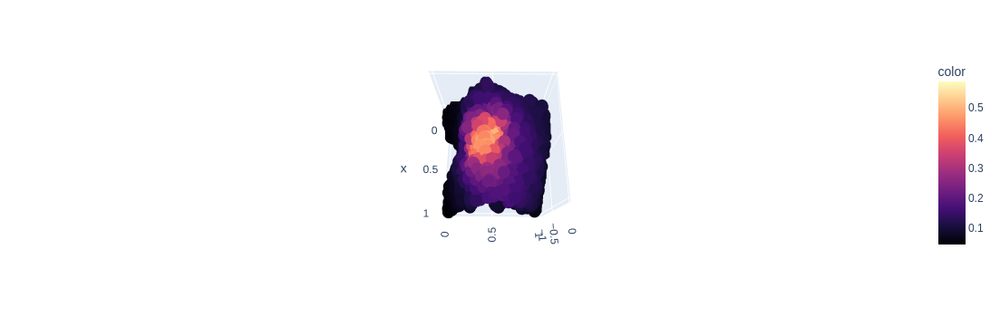

In [32]:
tbx5a_pd = np.squeeze(preds[sample_ind, :, :]).detach().cpu().numpy()

# plot true gene expression
fig = px.scatter_3d(x=points_samp[:, 0], y=points_samp[:, 1], z=-points_samp[:, 2], color=tbx5a_pd, 
                    color_continuous_scale="magma", opacity=1)
fig.show()

In [34]:
from sklearn.decomposition import PCA

n_components = 10
pca = PCA(n_components=n_components)

features_samp = np.squeeze(features[sample_ind, :, :].detach().cpu().numpy()).T
features_samp.shape
pca.fit(features_samp)
pca_array = pca.transform(features_samp)
pca_array.shape

(4096, 10)

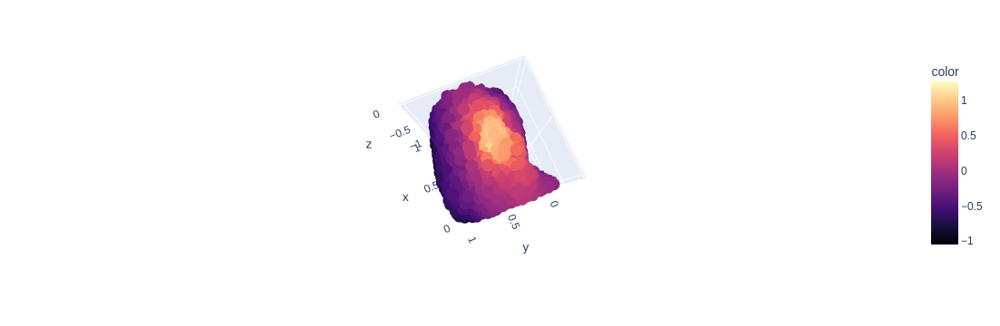

In [35]:
# plot true gene expression
fig = px.scatter_3d(x=points_samp[:, 0], y=points_samp[:, 1], z=-points_samp[:, 2], color=pca_array[:, 0], 
                    color_continuous_scale="magma", opacity=1)
fig.show()

In [38]:
test_dates = ["20240223"]
# generate dataloader to load fin point clouds
test_data = PointDataReg(data_root, split='test', training_dates=test_dates,
                                                                npoints=point_cloud_size, fluo_channel=None)

test_loader = DataLoader(test_data, batch_size=16, shuffle=True)

test_batch = next(iter(test_loader))

test_points = test_batch["data"]
# test_levels = batch["label"]
test_points = torch.transpose(test_points, 1, 2)

# pass to device
test_points = test_points.to(device)
# levels = levels.to(device)

# get softmax predictions
test_preds, _, _ = model(test_points)

In [26]:
features.shape

torch.Size([16, 128, 4096])

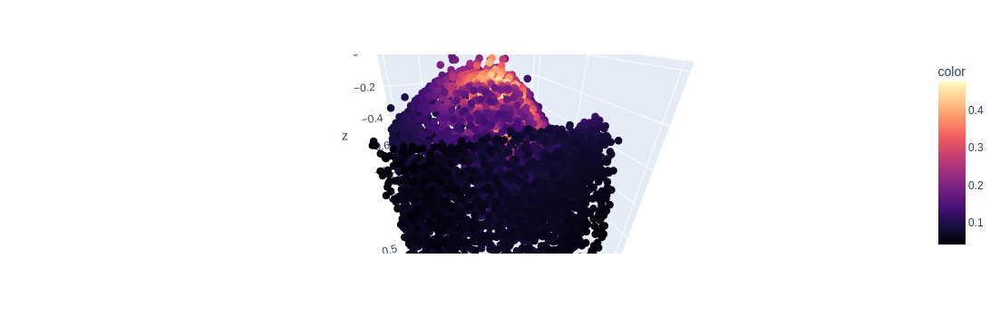

In [43]:
# plot prediction
sample_ind = 3
points_samp = np.squeeze(test_points[sample_ind, :, :]).T.cpu().numpy()
tbx5a_pd = np.squeeze(test_preds[sample_ind, :, :]).detach().cpu().numpy()

# plot true gene expression
fig = px.scatter_3d(x=-points_samp[:, 0], y=points_samp[:, 1], z=-points_samp[:, 2], color=tbx5a_pd,
                    color_continuous_scale="magma", opacity=1)

fig.update_traces(marker=dict(size=5))

fig.show()

In [44]:
n_components = 10
n_local = 64
pca = PCA(n_components=n_components)

point_features, crit_idxs, A_feat = model.backbone(test_points) 
features_samp = np.squeeze(point_features[sample_ind, :, :].detach().cpu().numpy()).T

pca.fit(features_samp[:, :n_local])
pca_array = pca.transform(features_samp[:, :n_local])
pca_array.shape

(4096, 10)

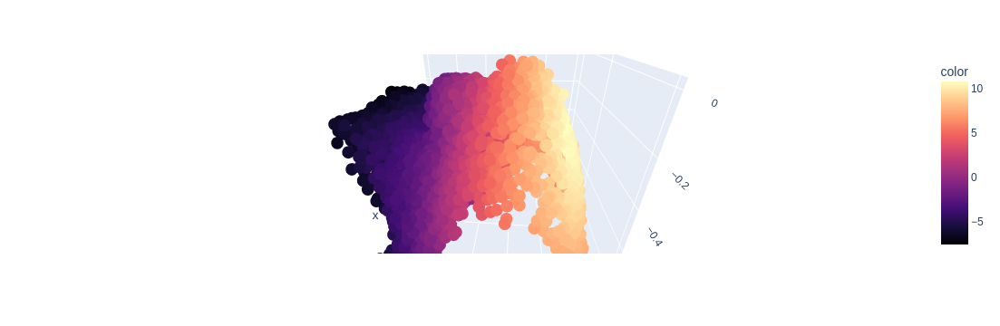

In [46]:
fig = px.scatter_3d(x=points_samp[:, 0], y=points_samp[:, 1], z=-points_samp[:, 2], color=pca_array[:, 0], 
                    color_continuous_scale="magma", opacity=1)
fig.show()